## Optical Character Recognition (OCR)

                            OCR
                             |
                      ------- ---------
                      |               | 
                Online Text      Offline Text
                                      |
                               ------- ---------
                               |               | 
                            Typed Text      Handwritten Text

In [1]:
import cv2
import pytesseract
from PIL import Image
import numpy as np
import sys
from skimage import io
from skimage.color import rgb2gray
from skimage.transform import rotate, resize
sys.path.insert(0, '/mnt/z/DataScience/Lambda/Labs/StorySquad/deskew')
from deskew import determine_skew
import os

from dotenv import load_dotenv, find_dotenv
load_dotenv()

True

## Files paths

In [7]:
dirpath = os.getcwd() #os abosulute current directory path
print("This Directory",dirpath)
parentDirectory = os.path.dirname(dirpath)
print(parentDirectory)
GrandparentDirectory = os.path.dirname(parentDirectory)
print(GrandparentDirectory)
# bsolutepath = os.path.abspath(__file__) #os abosulute current file path
# print(bsolutepath)
print(os.path.abspath(os.path.join(os.getcwd(), '..')))
out_path_myhand = os.getenv("LOCAL_PATH")
print("My_hand_Trained_data",out_path_myhand)
out_path_StorySquad = os.path.abspath(os.path.join(os.getenv("LOCAL_PATH"), "..",".."))
print(out_path_StorySquad)

This Directory /mnt/z/DataScience/Lambda/Labs/story-squad-ds/notebooks
/mnt/z/DataScience/Lambda/Labs/story-squad-ds
/mnt/z/DataScience/Lambda/Labs
/mnt/z/DataScience/Lambda/Labs/story-squad-ds
My_hand_Trained_data /mnt/z/DataScience/Lambda/Labs/StorySquad/My_OCR_test/My_hand_trained_data
/mnt/z/DataScience/Lambda/Labs/StorySquad


## Sample of image deskewing using "https://github.com/sbrunner/deskew"

In [140]:
#replace this with your own files, and paths.
sample_img = "/delicious.png"

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=3564x2673 at 0x7F0EB41ABDF0>


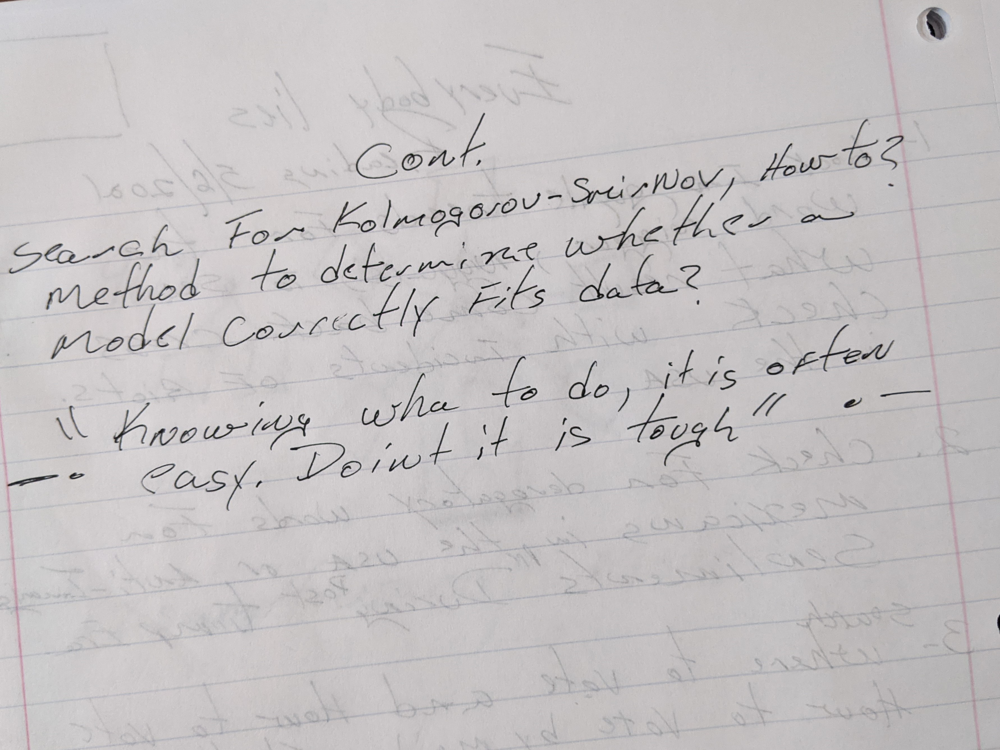

In [141]:
outputimage = Image.open(sample_img)
print(outputimage)
outputimage


In [135]:
image = io.imread(sample_img)
grayscale = rgb2gray(image)
angle = determine_skew(grayscale)
print(angle)
rotated = rotate(image, angle, resize=True) * 255
print(type(rotated))
io.imsave("output.png", rotated.astype(np.uint8))

-8.044692737430196
<class 'numpy.ndarray'>


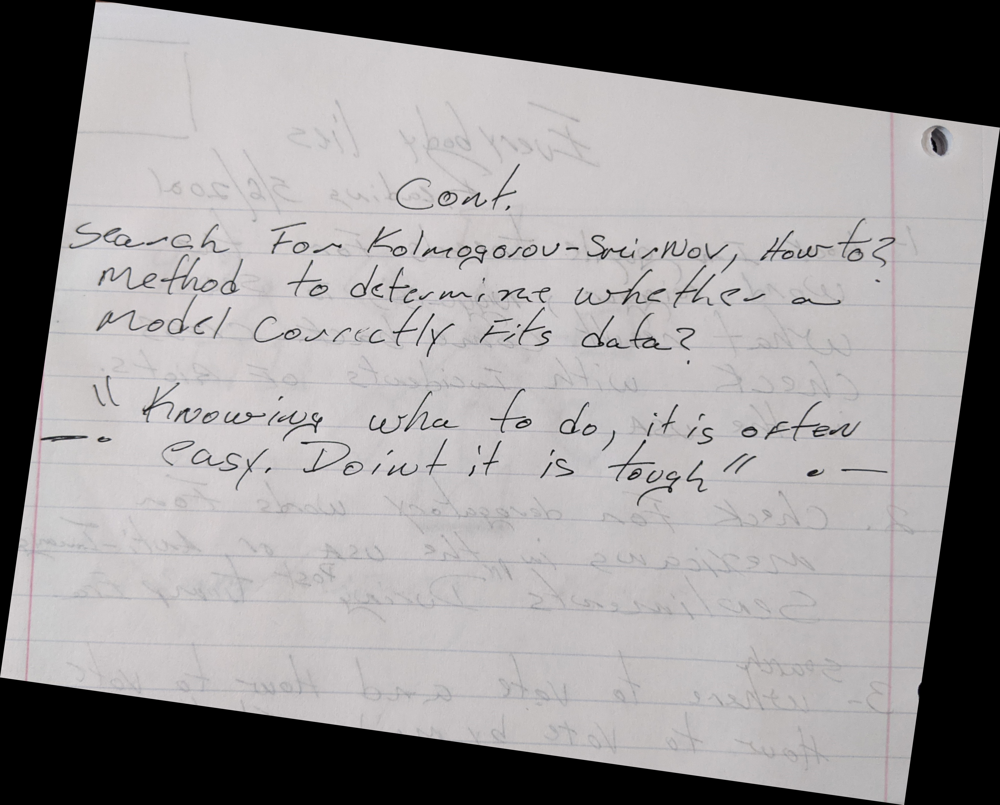

In [136]:
Image.open("output.png")

In [32]:
def pre_process_image(image):
    """This function will pre-process a image with: cv2 & deskew
    so it can be process by tesseract"""
    img = cv2.imread(image)
    img = cv2.resize(img, None, fx=.3, fy=.3) #resize using percentage
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) #change color format from BGR to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) #format image to gray scale
    img = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 5, 11) #to remove background
    return img
 #save preprocessed image 

In [242]:
def img_process(image):
    """This function will deskew"""
    cv2output = io.imread(image)
    angle = determine_skew(cv2output)
    print("angle rotation of image",angle)
    rotated = rotate(cv2output, angle, resize=True) * 255
    return rotated

    
